# Домашнее задание №2 - Линейные модели. Градиентный спуск

В этом домашнем задании мы с вами научимся обучать линейные модели регрессии и классификации при помощи очень мощного, но в то же время довольно понятного алгоритма, который называется **градиетный спуск**. Помимо линейных моделей он используется и для обучения самых сложных нейронных сетей! Также мы потренируемся применять готовые реализации линейных моделей для задач регрессии и бинарной классификации.

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
import random
import pandas as pd

from IPython.display import Image, Audio, display
from matplotlib import cm
from mpl_toolkits.mplot3d import Axes3D
from sklearn.exceptions import NotFittedError
from sklearn.linear_model import (LinearRegression,
                                  LogisticRegression)
from sklearn.datasets import fetch_california_housing
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import (StandardScaler,
                                   OneHotEncoder)
from sklearn.pipeline import Pipeline
from sklearn.datasets import make_classification
from sklearn.metrics import (r2_score, auc,
                             mean_squared_error, 
                             mean_absolute_error,
                             roc_auc_score,
                             confusion_matrix,
                             ConfusionMatrixDisplay,
                             roc_curve, RocCurveDisplay,
                             precision_score, recall_score,
                             f1_score, accuracy_score)
from sklearn.model_selection import train_test_split

from my_awesome_eda import run_eda

In [2]:
plt.rcParams["figure.figsize"] = 12, 9
sns.set_style("whitegrid")

SEED = 111
random.seed(SEED)
np.random.seed(SEED)

#### Маленькое теоретическое отступление

Основное свойство антиградиента (-1 * градиент) &ndash; он указывает в сторону наискорейшего убывания функции в данной точке. Соответственно, будет логично стартовать из некоторой точки, сдвинуться в сторону антиградиента, пересчитать антиградиент и снова сдвинуться в его сторону и т.д. Запишем это более формально.

Пусть $w_0$ &ndash; начальный набор параметров (коэффициентов линейной модели) ((например, нулевой или сгенерированный из некоторого, случайного распределения)). Тогда обычный градиентный спуск состоит в повторении следующих шагов до сходимости:


$$
    w_{k + 1} = w_{k} - \eta \nabla_{w} Q(w_{k}),
$$

где $\nabla_{w} Q(w_{k})$ &ndash; градиент функции потерь в точке $w_k$, а $\eta$ &ndash; скорость обучения (learning rate).

Градиентный спуск обычно останавливают, когда прошло заданное максимальное количество итераций или когда графиент близок к нулю (т.е. наши параметры практически не меняются). Для реализации второго варианта считают норму градиента (по сути длину вектора). Это можно сделать несколькими способами:

$$
l1_{norm} = \sum{|w_i|}
$$

$$
l2_{norm} = \sum{(w_i)^{2}}
$$

Попробуем разобраться на простом примере. Рассмотрим функцию от двух переменных:
$f(x, y) = \sin^2 x + \sin^2 y$

In [3]:
def f(w):
    """
    :param w: np.array(np.float) вектор из 2-х элементов
    :return: np.float
    """
    
    return np.sum(np.sin(w)**2)

Обратите внимание, что $x$ - numpy-array вектор длины 2.

***Reminder:***  
Что мы хотим? Мы хотим найти минимум этой функции (в машинном обучении мы обычно хотим найти минимум **функции потерь**, например, MSE), а точнее найти $w_1$ и $w_2$ такие, что при них значение $f(w_1, w_2)$ минимально, то есть *точку экстремума*.  
  
Как мы будем искать эту точку? Используем методы оптимизации (в нашем случае - *минимизации*). Одним из таких методов и является **градиентный спуск**.

### Задание 1. Градиентный спуск для функции $f$ (1 балл)

Реализуйте функцию, которая будет осуществлять градиентный спуск для функции $f$:

*Примечание:* Вам нужно посчитать частные производные именно **аналитически** и **переписать их в код**, а не считать производные численно (через отношение приращения функции к приращению аргумента) -- в этих двух случаях могут различаться ответы, поэтому будьте внимательны.

In [4]:
def grad_f(w): 
    """
    Градиент функциии f, определенной выше.
        :param w: np.array[2]: float вектор из 2-х элементов
        :return: np.array[2]: float вектор из 2-х элементов
    """
    
    grad = 2 * np.sin(w) * np.cos(w)
    
    return grad

Проверим, что градиент принимает вектор из двух чисел и выдает на этой точке верное значение

In [5]:
assert np.allclose(grad_f(np.array([1, 2])), 
                   np.array([0.90929743, -0.7568025])), "Что-то не так!"

In [6]:
def grad_descent_2d(f, grad_f, lr, num_iter=100, x0=None):
    """
    Функция, которая реализует градиентный спуск в минимум для функции f от двух переменных. 
        :param f: скалярная функция двух переменных
        :param grad_f: функция, возвращающая градиент функции f (устроена как реализованная вами выше grad_f)
        :param lr: learning rate алгоритма
        :param num_iter: количество итераций градиентного спуска
        :return: np.array[num_iter, 2] пар вида (x, f(x))
    """
    
    w0 = np.random.random(2)

    # будем сохранять значения аргументов и значений функции 
    # в процессе град. спуска в переменную history
    history = []

    # итерация цикла == шаг градиентнго спуска
    curr_w = w0.copy()
    for iter_num in range(num_iter):
        entry = np.hstack((curr_w, f(curr_w)))
        history.append(entry)
    
        curr_w -= lr * grad_f(curr_w) # Не забудьте про lr!

    return np.vstack(history)

Визуализируем точки градиентного спуска на 3D-графике нашей функции. Звездочками будут обозначены точки (тройки $w_1, w_2, f(w_1, w_2)$), по которым Ваш алгоритм градиентного спуска двигался к минимуму (Для того, чтобы написовать этот график, мы и сохраняли значения $cur\_w_1, cur\_w_2, f(cur\_w_1, cur\_w_2)$ в `steps` в процессе спуска).

Если у Вас правильно написана функция `grad_descent_2d`, то звездочки на картинке должны сходиться к одной из точек минимума функции. Вы можете менять начальные приближения алгоритма, значения `lr` и `num_iter` и получать разные результаты.

In [7]:
def gradient_desc_vis(f, grad_f, lr=0.1, num_iter=20):
    steps = grad_descent_2d(f, grad_f, lr=lr, num_iter=num_iter)
    
    X, Y = np.meshgrid(np.linspace(-3, 3, 100), np.linspace(-3, 3, 100))

    fig = plt.figure(figsize=(16, 10))
    ax = fig.add_subplot(projection="3d")

    zs = np.array([f(np.array([x,y]))
                  for x, y in zip(np.ravel(X), np.ravel(Y))])
    Z = zs.reshape(X.shape)


    ax.plot_surface(X, Y, Z, cmap=cm.coolwarm, zorder=2)

    ax.plot(xs=steps[:, 0], ys=steps[:, 1], zs=steps[:, 2],
            marker="*", markersize=20, zorder=3, 
            markerfacecolor="y", lw=3, c="black")

    ax.set_zlim(0, 5)
    ax.view_init(elev=60)
    plt.show()
    
    return steps

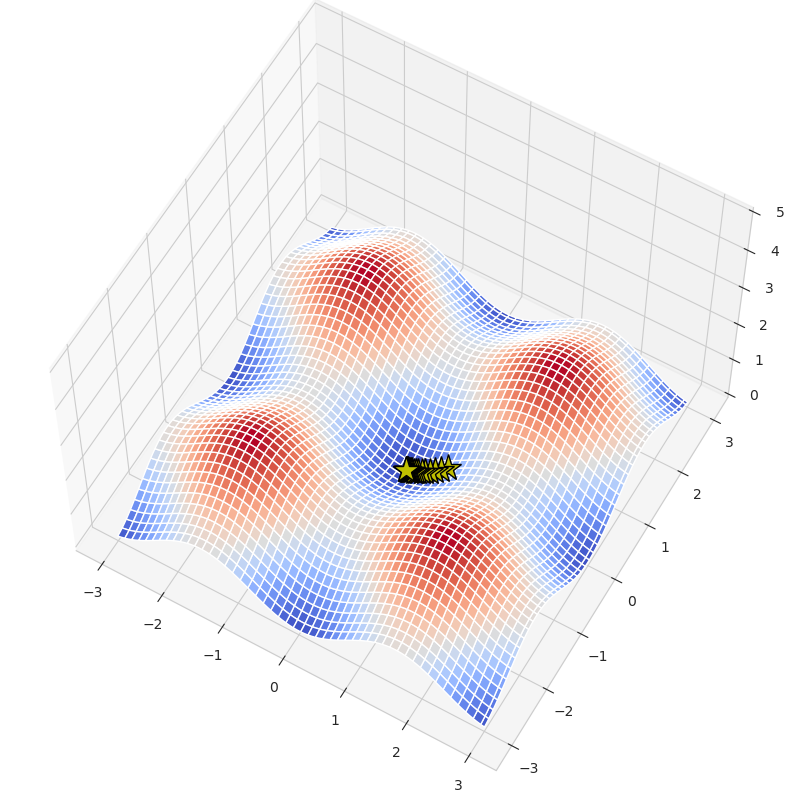

In [8]:
steps = gradient_desc_vis(f, grad_f)

Посмотрим на зависимость значения функции от шага градиентного спуска.

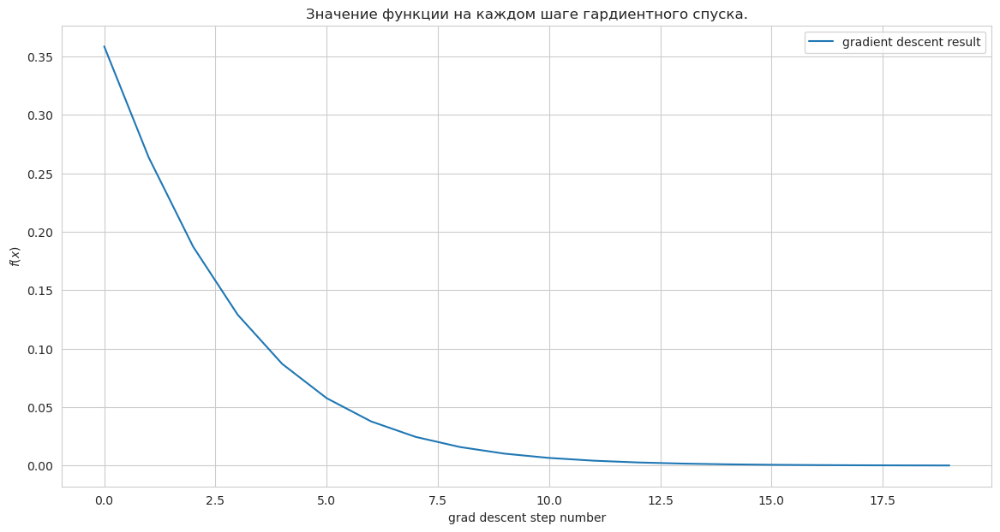

In [9]:
plt.figure(figsize=(14,7))
plt.xlabel("grad descent step number")
plt.ylabel("$f(x)$")
plt.title("Значение функции на каждом шаге гардиентного спуска.")

f_values = list(map(lambda x: x[2], steps))
plt.plot(f_values, label="gradient descent result")
plt.legend();

### Задание 2. Реализация линейной регресии (суммарно 9 баллов)

Так как мы будем использовать градиентный спуск для обучения модели, важной часть является реализация функции потерь и функции для расчета ее градиента. Перем началом стоит напомнить, как считать градиент MSE. Вывод этой формулы можно найти  [здесь](https://medium.com/analytics-vidhya/linear-regression-gradient-descent-intuition-and-math-c9a8f5aeeb22)

$$
    MSE = \frac{1}{N}\sum(y_{true} - y_{pred}) ^ 2
$$

$$
    \nabla{MSE} = \frac{2}{N} X^T (y_{pred} - y_{true})
$$

Здесь имеется в виду именно матричное умножение.

#### Задание 2.1. MSE и ее градиент (2 балла)

In [10]:
def mse(y_true, y_pred):
    """
    Функция потерь MSE.
        :param y_true: np.array[n_samples]: вектор из правильных ответов
        :param y_pred: np.array[n_samples]: вектор из предсказаний модели
        :return: значение функции потерь
    """
    
    if  y_true.shape[0] != y_pred.shape[0]:
        raise ValueError("Number of samples in both vectors should be equal")
    
    return np.sum((y_true - y_pred)**2) / y_true.shape[0]


def mse_grad(y_true, y_pred, X):
    """
    Функция для расчета градиента MSE.
        :param y_true: np.array[n_samples]: вектор из правильных ответов
        :param y_pred: np.array[n_samples]: вектор из предсказаний модели
        :param X: np.array[n_samples, n_features]: матрица объекты x признаки
        :return: градиент функции потерь MSE
    """
    
    if  y_true.shape[0] != y_pred.shape[0]:
        raise ValueError("Number of samples in both vectors should be equal")
    
    return 2 * (X.T @ (y_pred - y_true)) / y_true.shape[0]


class MSELoss:
    """
    Класс, реализующий функцию потерь MSE. Нужен для того, чтобы
    объединять в одном месте функцию потерь и градиент для нее.
    """
    
    def __call__(self, y_true, y_pred):
        return mse(y_true, y_pred)
    
    def calculate_gradient(self, y_true, y_pred, X):
        return mse_grad(y_true, y_pred, X)

Мы будем использовать следующий класс для расчета градиента наших функций потерь:

In [11]:
class BasicGradientDescent:
    """
    Класс, позволяющий делать шаги градиентного спуска,
    а также рассчитывающих норму градиента.
    """
    
    def __init__(self, loss_function, grad_norm):
        self.loss = loss_function
        self.grad_norm = grad_norm
        
    
    def step(self, y, y_pred, X):
        grad_i = self.loss.calculate_gradient(y, y_pred, X)
        grad_i_norm = self._calculate_grad_norm(grad_i)
        
        return grad_i, grad_i_norm
            
            
    def _calculate_grad_norm(self, grad_i):
        if self.grad_norm == "l1":
            return np.abs(grad_i).sum()
        elif self.grad_norm == "l2":
            return np.sqrt(np.square(grad_i).sum())
        else:
            raise ValueError(f"I can't calculate {self.grad_norm} norm of gradient")

В данном задании нужно будет реализовать линейную регрессию и обучить ее при помощи градиентного спуска. Для этого нужно будет заполнять пропуски кода в соответствующих классах. Для начала мы реализуем базовый класс для всех линейных моделей, от которого потом будем наследоваться при реализации линейной и логистической регресий. Не переживайте, этот класс уже реализован, вам достостаточно просто разобраться с кодом.

In [12]:
class BaseLinearModel:
    """
    Класс, который представляет из себя базовую линейную модель, наследуюясь от которого, мы будем
    реализовывать линейную и логистическую регрессии.
    """
    
    def __init__(self, learning_rate, 
                 loss_function, fit_intercept,
                 n_iter, tol, optimizer, grad_norm):
        """
        Конструктор нашего класса. 
            :param learning_rate: скорость обучения
            :param loss_function: функция потерь (MSE или кросс-энтропия)
            :param fit_intercept: нужно ли нам включать свободных член в модель
            :param n_iter: количество итераций градиентного спуска
            :param tol: параметр для остановки градиентного спуска,
                        если норма градиента (l1 или l2) меньше tol, то останавливаемся
            :param optimizer: класс, который будет рассчитывать градиент и его норму
            :param grad_norm: тип нормы градиента l1 или l2
        """
        
        self.learning_rate = learning_rate
        self.loss = loss_function
        self.fit_intercept = fit_intercept
        self.n_iter = n_iter
        self.tol = tol
        self.grad_norm = grad_norm
        self.optimizer = optimizer(loss_function, grad_norm)
        
        # В начале параметры модели не заданы
        self.W = None
        
        
    def fit(self, X, y):
        """
        Метод для обучения нашей модели 
            :param X: матрица объекты x признаки
            :param y: вектор значений целевой переменной
            :return: обученная модель
        """
        
        # Сделаем из y вектор-столбец (n_samples, 1)
        y = y.reshape(-1, 1)
        n_samples = X.shape[0]
        
        # Добавим колонку из 1 в матрицу X
        if self.fit_intercept:
            ones_column = np.ones((n_samples, 1))
            X_new = np.hstack((ones_column, X))
        
        n_features = X_new.shape[1]
        
        # Инициализируем веса модели
        if self.W is None:
            self.W = np.random.randn(n_features, 1)
        
        # Обучаем модель градиентным спуском
        for i in range(self.n_iter):
            y_pred = self.predict(X)
            grad_i, grad_i_norm = self.optimizer.step(y, y_pred, X_new)
            
            # Если градиент близок к 0, останавливаемся
            if grad_i_norm <= self.tol:
                return self
            
            else:
                self.W -= self.learning_rate * grad_i
        
        return self
    
    
    def predict(self, X):
        raise NotImplementedError("It is a basic class for all linear models. You should implement it for descendant class.")
    
    
    def __repr__(self):
        return "Base linear model without prediction skill :("

#### Задание 2.2. Предсказания линейной регрессии (3 балла)

Реализуйте метод `predict` у класса `CustomLinearRegression`, не забудьте про свободный член!

In [13]:
class CustomLinearRegression(BaseLinearModel):
    def __init__(self, learning_rate: float = 1e-2, 
                 loss_function=MSELoss(), fit_intercept=True,
                 n_iter=1000, tol=1e-5, optimizer=BasicGradientDescent, grad_norm="l1"):
        
        # Если вы не проходили наследование и в частности `super`, то не страшно
        # коротко, с помощью этого мы можем вызывать методы родительского класса
        # в частности здесь мы используем метод `init`
        super().__init__(learning_rate=learning_rate, 
                         loss_function=loss_function, fit_intercept=fit_intercept,
                         n_iter=n_iter, tol=tol, optimizer=optimizer, grad_norm=grad_norm)
        
    
    def predict(self, X_test):
        """
        Метод для вычисления предсказаний 
            :param X_test: np.array[n_test_samples, n_features]: 
                           матрица объекты x признаки (тестовый датасет)
            :return: y_pred: np.array[n_test_samples, 1]: предсказания модели
        """
        
        if self.W is None:
            raise NotFittedError("This CustomLinearRegression instance is not fitted yet, run fit method.")
        
        n_test_samples = X_test.shape[0]
        if self.fit_intercept:
            ones_column = np.ones((n_test_samples, 1))
            X_test = np.hstack((ones_column, X_test))
            
        y_pred = X_test@self.W
        
        return y_pred
    
    
    def __repr__(self):
        return "My custom linear regression"

##### Проверим нашу реализацию на простом примере

In [14]:
X = np.random.randn(100, 1)
y = 2 * X + 5 + 0.5 * np.random.randn(100, 1)

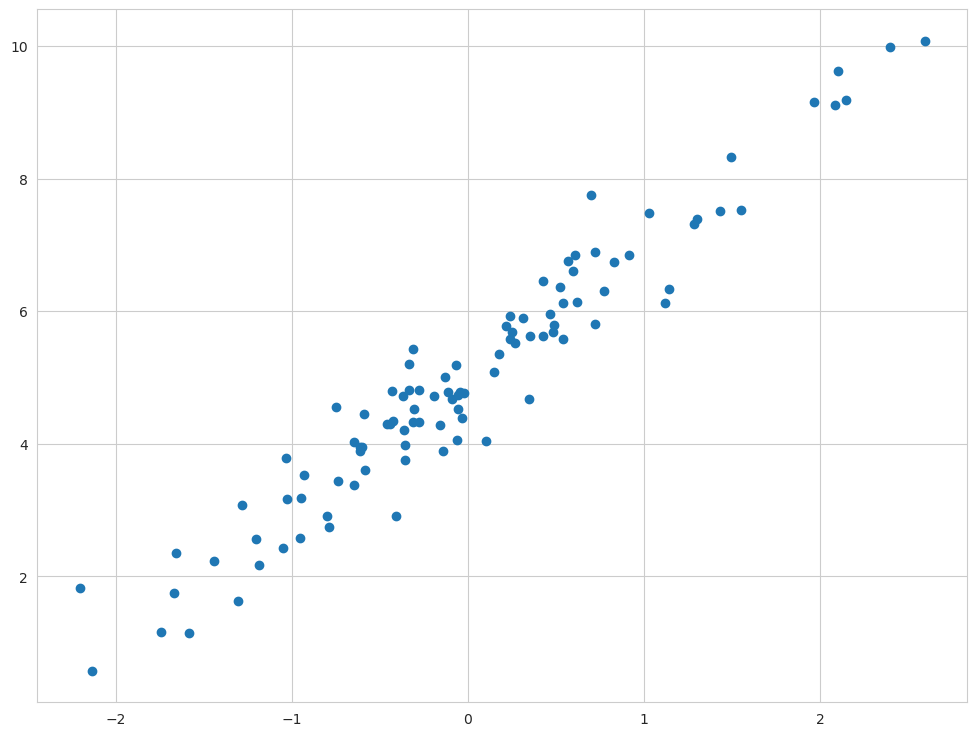

In [15]:
plt.scatter(X, y);

In [16]:
custom_lin_reg = CustomLinearRegression()

In [17]:
custom_lin_reg.fit(X, y)

My custom linear regression

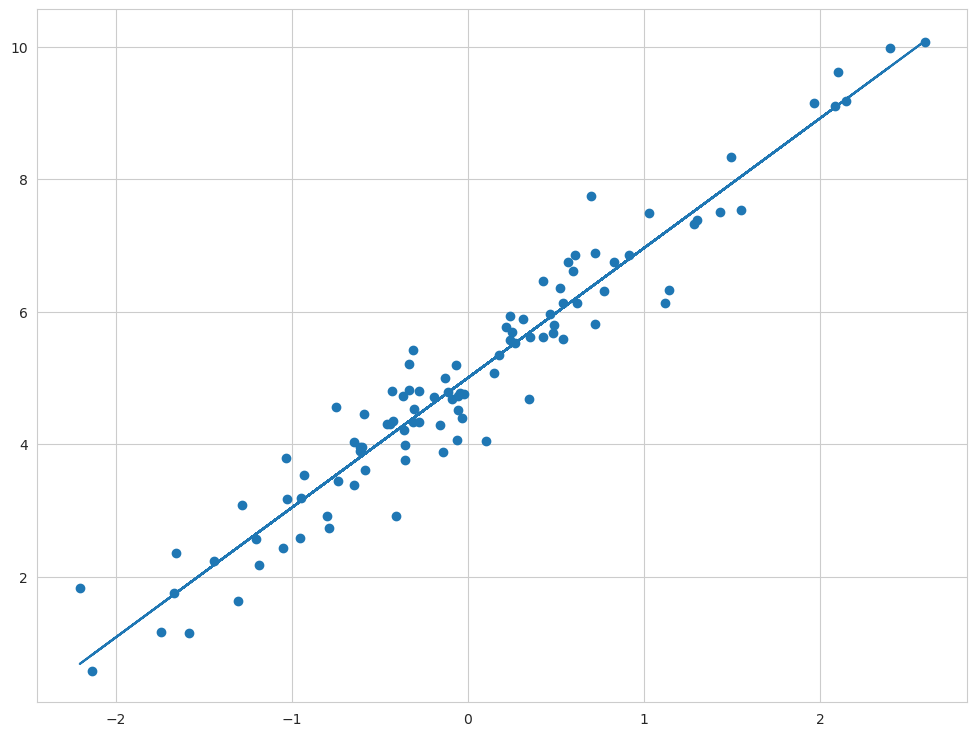

In [18]:
plt.scatter(X, y)
plt.plot(X, custom_lin_reg.predict(X));

#### Задание 2.3. Используем встроенную линейную регрессию (4 балла)

Поработаем с данными о ценах на дома в Калифорнии. Постройте модель линейной регресии при помощи `LinearRegression` из `sklearn`. Не забудьте разделить данные на тренировочную и тестовую части, а также правильно предобработать признаки. В конце воспользуйтесь какими-то изученными метриками регресии и сделайте выводы о качестве полученной модели, а также о том, какие признаки наиболее важны с точки зрения полученной модели.

In [19]:
data = fetch_california_housing()
X, y = data["data"], data["target"]
feature_names = data["feature_names"]

Ваш ход:

Praise the Omnissiah! Welcome to the Sanctum of Exploratory Data Analysis.

Number of Observations (Rows): 20640
Number of Parameters (Columns): 8

Data Types of Each Column:
MedInc       float64
HouseAge     float64
AveRooms     float64
AveBedrms    float64
Population   float64
AveOccup     float64
Latitude     float64
Longitude    float64

Numerical features: MedInc, HouseAge, AveRooms, AveBedrms, Population, AveOccup, Latitude, Longitude
String features: 0
Categorical features: 0

Counts and Frequencies for Categorical Features:

Descriptive Statistics for Numerical Features:
         MedInc  HouseAge  AveRooms  AveBedrms  Population  AveOccup  \
count  20640.00  20640.00  20640.00   20640.00    20640.00  20640.00   
mean       3.87     28.64      5.43       1.10     1425.48      3.07   
std        1.90     12.59      2.47       0.47     1132.46     10.39   
min        0.50      1.00      0.85       0.33        3.00      0.69   
25%        2.56     18.00      4.44       1.01      78

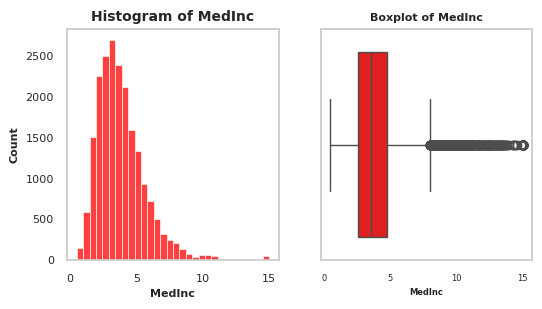

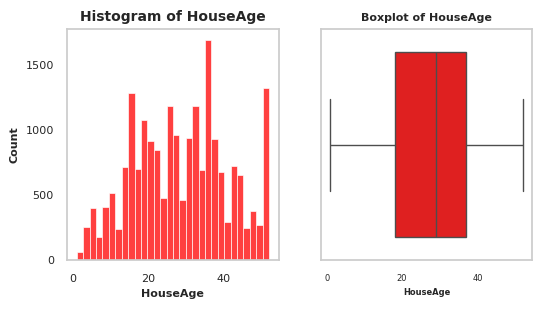

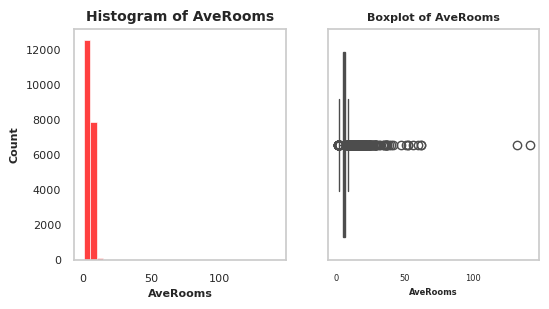

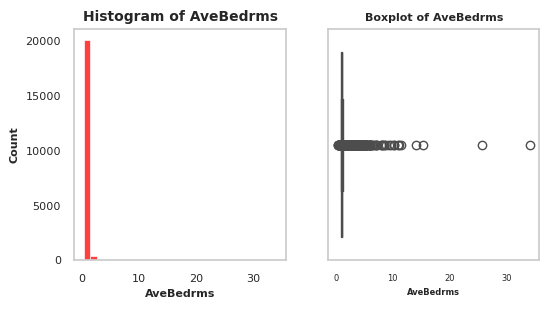

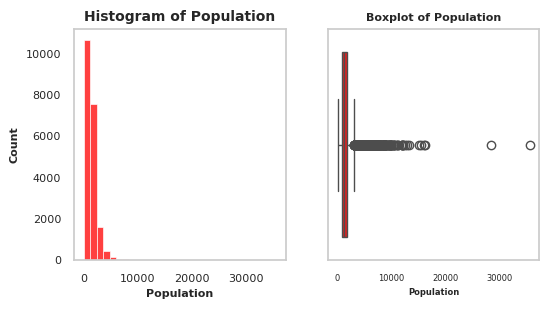

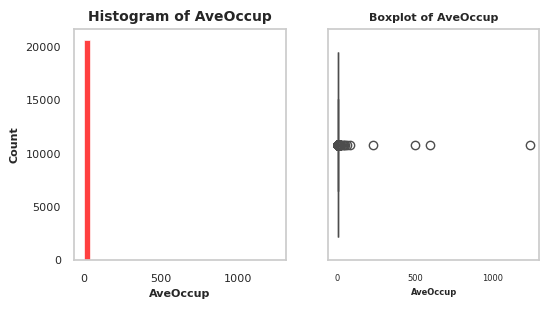

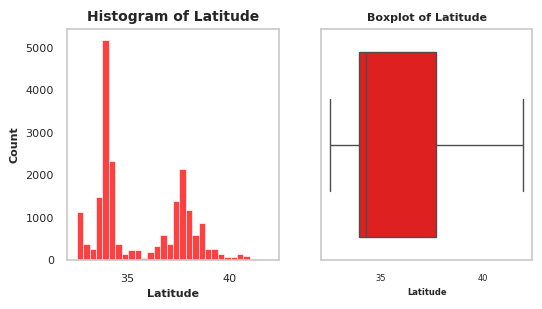

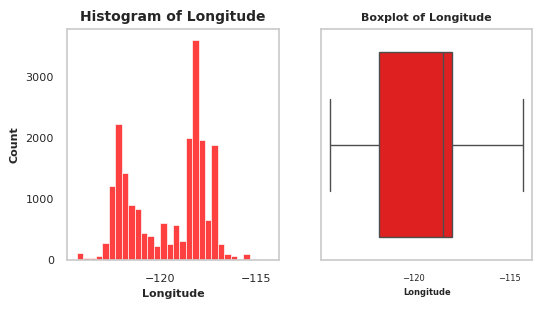


Correlation Heatmap:


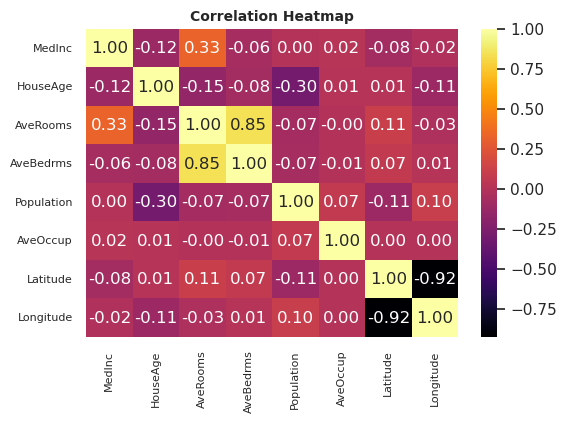


Outliers for Numerical Features:
MedInc: 681
HouseAge: 0
AveRooms: 511
AveBedrms: 1424
Population: 1196
AveOccup: 711
Latitude: 0
Longitude: 0

Missing Values:
Total Missing Values: 0
Rows with Missing Values: 0
Columns with Missing Values: 

Missing Values Proportion:


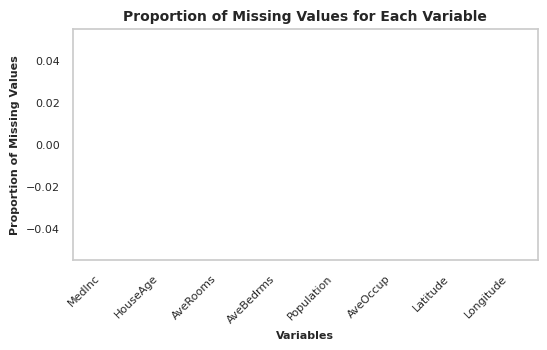


Duplicate Rows:
Number of Duplicate Rows: 0

May the data guide you, and the Omnissiah bless your analysis.


In [20]:
# для начала посмотрим на данные
X = pd.DataFrame(data=X, columns=feature_names)
run_eda(X, category_values=10)

Датасет California Housing включает следующие колонки:
* MedInc: медианный доход домохозяйства.
* HouseAge: медианный возраст домов в районе.
* AveRooms: среднее количество комнат.
* AveBedrms: среднее количество спален.
* Population: население района.
* AveOccup: среднее количество людей, проживающих в доме.
* Latitude: широта района.
* Longitude: долгота района.
Все признаки численные, категориальных нет. Пропущенных и дублированных значений нет. Достаточно много выбросов, что может быть вызвано разной плотностью населения в Калифорнии в городах и ~~на пляже~~ между городами. В общем, выбросов много, и выкидывать эти наблюдения мы не будем, попытаемся так. У всех признаков разные размерности - значит будем проводить стандартизацию. Широта и долгота имеют два пика. А еще я наконец-то начинаю понимать то, что нам на статистике в первом семестре рассказывыали (прошел стресс от перебора вручную AIC), и я обратила внимание на Correlation Heatmap. У нас есть два параметра с положительной корреляцией и два с отрицательной. Количество комнат положительно коррелирует с количеством спален (0.85 коэффициент), что выглядит разумно - чем больше комнат, тем больше спален. С широтой и долготой я пробовала погуглить почему так, но ничего не нашла. С целью улучшения модели, можно исключить по одному параметру из каждой пары (я не сделала это в датасете про диабетиков из предыдущего дз, но я дообучаюсь). Уберем, пожалуй, количество спален, потому что спальни это тоже комнаты, и долготу (она отрицательная потому что, а все остальные параметры у нас положительные).
В процессе написания до меня доходит, что широта и долгота - это координаты Y и X соответственно, если представить их как просто координатную сетку, то это значит, что Калифорния как бы вытянута по диагонали. Если посмотреть на карту, так и есть, она вытянута вдоль пляжа.

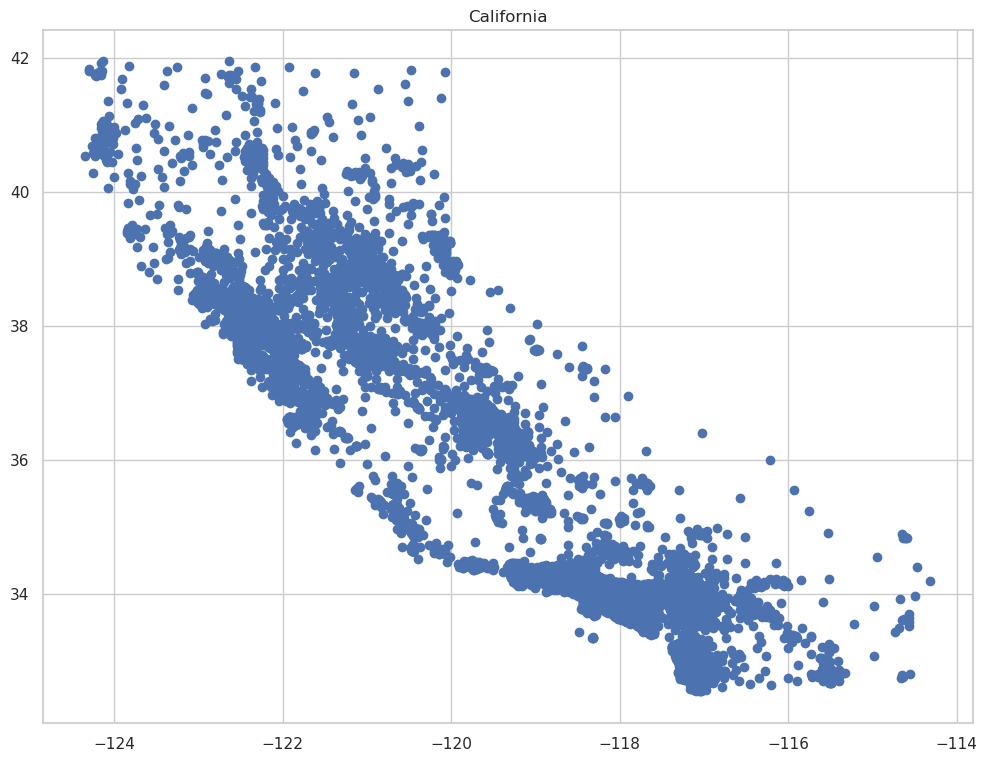

In [21]:
plt.scatter(x=X['Longitude'], y=X['Latitude'])
plt.title('California')
plt.show()

Итак, план:
1. Убираем AveBedrms и Longitude
2. Делим на тренировочную и тестовую выборки
3. Проводим стандартизацию по тренировочной выборке
4. Обучаем
5. Предсказываем
6. Смотрим на метрики модели
7. Можем попробовать другие колонки повыкидвыать или не выкидывать и сделать те же шаги, сравнить метрики.

In [22]:
X1 = X[['MedInc', 'HouseAge', 'AveRooms', 'Population', 'AveOccup', 'Latitude']]
cols = X1.columns.tolist()

In [23]:
X_train, X_test, y_train, y_test = train_test_split(X1,
                                                    y,
                                                    test_size=0.25,
                                                    random_state=SEED)

In [24]:
# не могу отделаться от мысли, что один мой знакомый называет это пиплайн
linreg_pipeline = Pipeline(steps=[
    ("scaler", StandardScaler()),
    ("lin_reg", LinearRegression())
])
linreg_pipeline

Pipeline(steps=[('scaler', StandardScaler()), ('lin_reg', LinearRegression())])

In [25]:
linreg_pipeline.fit(X_train, y_train)

Pipeline(steps=[('scaler', StandardScaler()), ('lin_reg', LinearRegression())])

In [26]:
y_predicted = linreg_pipeline.predict(X_test)

In [27]:
r_squared_val, mse_val, mae_val = r2_score(y_test, y_predicted), mean_squared_error(y_test, y_predicted), mean_absolute_error(y_test, y_predicted)
print(f'r2_score = {round(r_squared_val, 4)}',
      f'MSE = {round(mse_val, 4)}', 
      f'MAE = {round(mae_val, 4)}', sep='\n'
)

r2_score = 0.5068
MSE = 0.6634
MAE = 0.6002


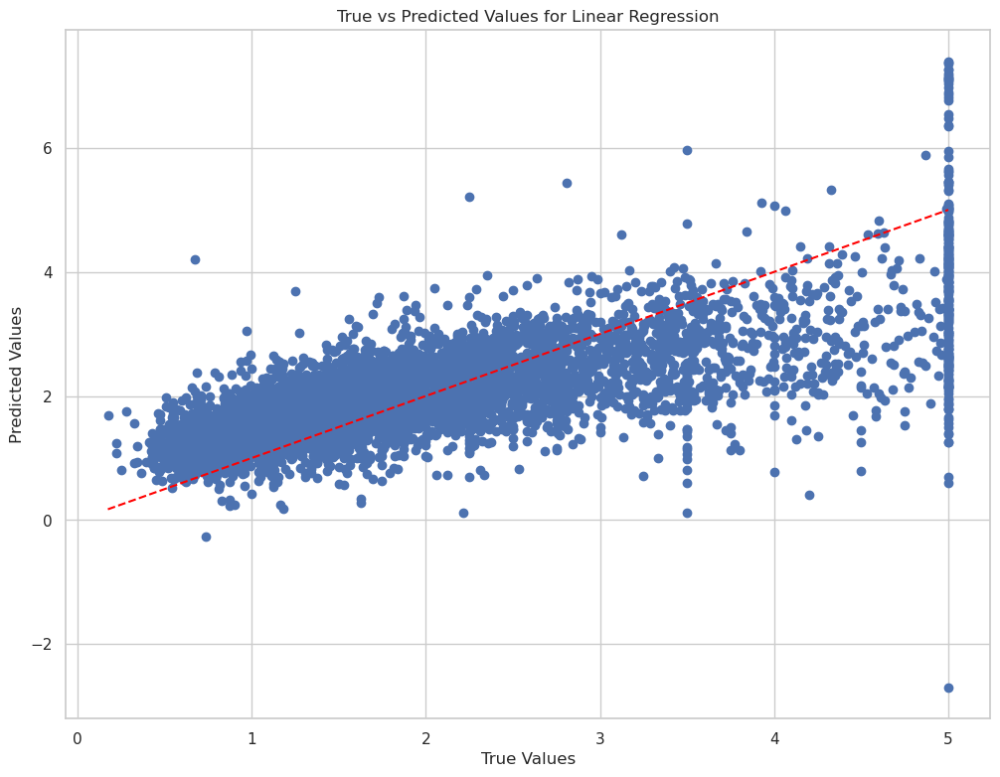

In [28]:
plt.scatter(y_test, y_predicted)
plt.plot([min(y_test), max(y_test)], [min(y_test), max(y_test)], linestyle="--", color='red')
plt.xlabel('True Values')
plt.ylabel('Predicted Values')
plt.title('True vs Predicted Values for Linear Regression')
plt.show()

Модель улавливает тенденцию, но как-то плохо предсказывает верхний ценовой диапазон, возможно мы что-то не учитываем или выкинули что-то важное? Наибольший вклад вносит средний доход домохозяйства (чтобы это не значило).

Давайте попробуем ничего не выкидывать. 

А можно вопрос? - есть какой-то аналог AIC здесь? посмотреть какая модель лучше, какие лучше выкинуть параметры или наоборот добавить? или тут так не принято?

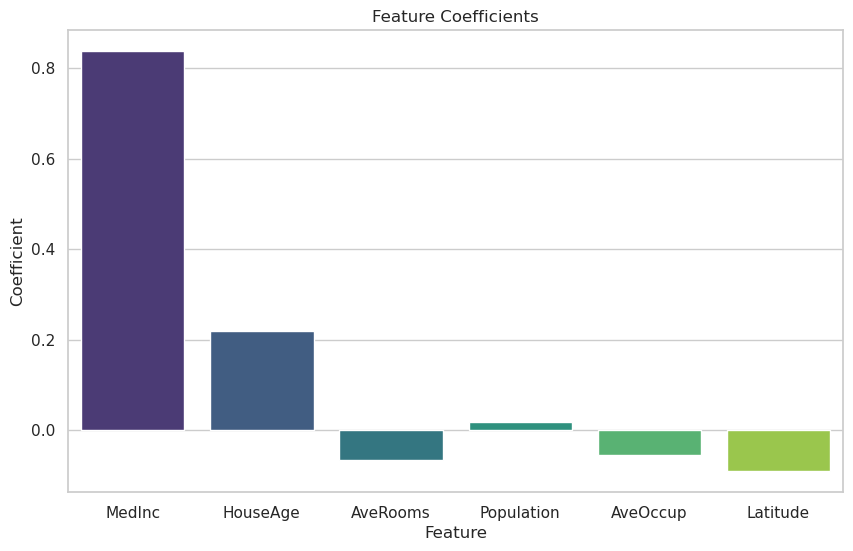

In [29]:
final_model = linreg_pipeline.named_steps['lin_reg']
coefficients = final_model.coef_
feature_names = cols

coef_df = pd.DataFrame({'Feature': feature_names, 'Coefficient': coefficients})
plt.figure(figsize=(10, 6))
sns.barplot(x='Feature', y='Coefficient', data=coef_df, hue='Feature', palette='viridis')
plt.title('Feature Coefficients')
plt.show()

In [30]:
X_train_1, X_test_1, y_train_1, y_test_1 = train_test_split(X,
                                                            y,
                                                            test_size=0.25,
                                                            random_state=SEED)
linreg_pipeline.fit(X_train_1, y_train_1)
y_predicted_1 = linreg_pipeline.predict(X_test_1)
r_squared_val_1, mse_val_1, mae_val_1 = r2_score(y_test_1, y_predicted_1), mean_squared_error(y_test_1, y_predicted_1), mean_absolute_error(y_test_1, y_predicted_1)
print(f'r2_score = {round(r_squared_val_1, 4)}',
      f'MSE = {round(mse_val_1, 4)}', 
      f'MAE = {round(mae_val_1, 4)}', sep='\n')

r2_score = 0.6021
MSE = 0.5352
MAE = 0.5339


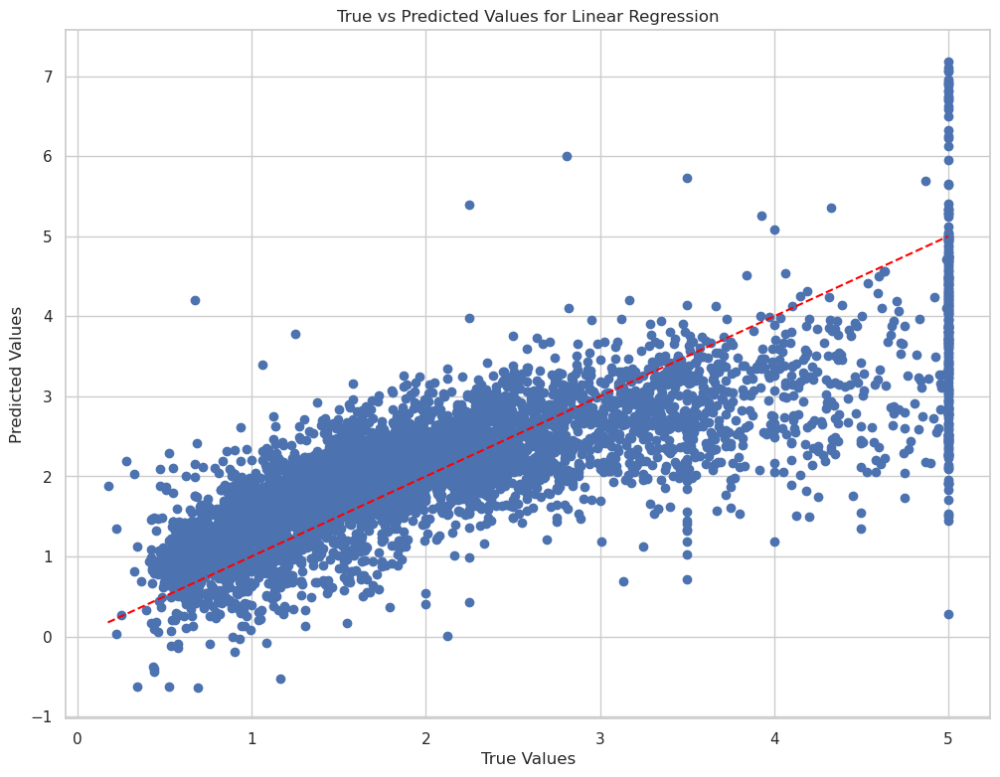

In [31]:
plt.scatter(y_test_1, y_predicted_1)
plt.plot([min(y_test_1), max(y_test_1)], [min(y_test_1), max(y_test_1)], linestyle="--", color='red')
plt.xlabel('True Values')
plt.ylabel('Predicted Values')
plt.title('True vs Predicted Values for Linear Regression')
plt.show()

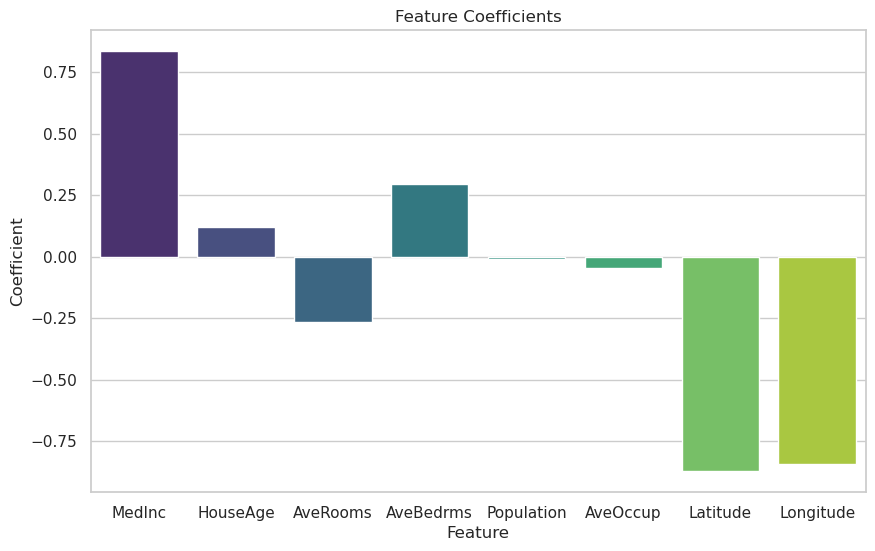

In [32]:
full_cols = X.columns.tolist()
final_model = linreg_pipeline.named_steps['lin_reg']
coefficients = final_model.coef_
feature_names = full_cols

coef_df = pd.DataFrame({'Feature': feature_names, 'Coefficient': coefficients})
plt.figure(figsize=(10, 6))
sns.barplot(x='Feature', y='Coefficient', data=coef_df, hue='Feature', palette='viridis')
plt.title('Feature Coefficients')
plt.show()

Как будто получше стало, R^2 поближе к единице, MSE поменьше стал, но верхний ценовой диапазон все равно плохо предсказывается, и параметров у модели побольше стало. 

Наибольший вклад теперь вносят средний доход домохозяйства и координаты, причем как гирота, так и долгота, выглядит странно.

А может можно как-то отдельно построить модельки для богатых и модельки для бедных? Но как-нибудь в другой раз.

### Задание 3. Реализация логистической регресии (суммарно 10 баллов)

Логистическая регрессия не очень сильно отличается от обычной линейной регрессии и используется в задах классификации. Так как здесь мы снова будем пользоваться градиентным спуском, то нужно определить функцию потерь и ее градиент. Одним из самых популярных вариантов в задаче бинарной классификации является бинарная кросс-энтропия (BCE).

$$\mathcal L_{BCE}(y, \hat y) = -\sum_i \left[y_i\log\sigma(\hat y_i) + (1-y_i)\log(1-\sigma(\hat y_i))\right].$$

где $y$ это  таргет желаемого результата и $\hat y$ является выходом модели. $\sigma$ - это [*логистическая* функция](https://en.wikipedia.org/wiki/Sigmoid_function), который преобразует действительное число $\mathbb R$ в вероятность $[0,1]$.

Единственная проблема данной функции это возможность получить 0 под знаком логарифма, что не очень хорошо. Попробуем справить с этим "в лоб". Скажем, что наши предсказания могут принимать значения от 0 + eps до 1 - eps, где eps очень маленькое число.

#### Задание 3.1. Реализация сигмоиды (0.5 баллов)

Реализуйте функцию `sigmoid`, которая переводит действительное число $\mathbb R$ в вероятность $[0,1]$.

In [33]:
def sigmoid(output):
    return 1 / (1 + np.exp(-output))

#### Задание 3.2. BCE Loss и ее градиент (2.5 балла)

Так как мы с вами только начинаем изучать машинное обучение, то было бы слишком жестоко просить вас вычислить градиент BCE Loss (он не так сложен, просто нужно привыкнуть). Поэтому сразу напишем формулу для него:

$$
\nabla{\mathcal L_{BCE}(y, \hat y), X} = X^T (\sigma({\hat{y}}) - y)
$$

In [34]:
def bce(y_true, y_pred, eps=1e-15):
    """
    Функция потерь BCE.
        :param y_true: np.array[n_samples]: вектор из правильных ответов 0/1
        :param y_pred: np.array[n_samples]: вектор из предсказаний модели (вероятности)
        :return: значение функции потерь
    """
    
    if  y_true.shape[0] != y_pred.shape[0]:
        raise ValueError("Number of samples in both vectors should be equal")
        
    n = y_true.shape[0]
    
    # So I want escape log(0)
    y_pred = np.clip(y_pred, eps, 1 - eps)
    
    bce_value = (- 1 / y_true.shape[0]) * np.sum(y_true * np.log(y_pred) + (1 - y_true) * np.log(1 - y_pred))
    return bce_value
    

def bce_grad(y_true, y_pred, X):
    """
    Функция потерь BCE.
        :param y_true: np.array[n_samples]: вектор из правильных ответов 0/1
        :param y_pred: np.array[n_samples]: вектор из предсказаний модели (вероятности)
        :param X: np.array[n_samples, n_features]: матрица объекты x признаки
        :return: значение функции потерь
    """
    
    if  y_true.shape[0] != y_pred.shape[0]:
        raise ValueError("Number of samples in both vectors should be equal")
        
    return X.T @ (y_pred - y_true)


class BCELoss:
    """
    Класс, реализующий функцию потерь BCE. Нужен для того, чтобы
    объединять в одном месте функцию потерь и градиент для нее.
    """
    
    def __call__(self, y_true, y_pred):
        return bce(y_true, y_pred)
    
    def calculate_gradient(self, y_true, y_pred, X):
        return bce_grad(y_true, y_pred, X)

#### Задание 3.3. Предсказания логистической регрессии (2 балла)

Реализуйте метод `predict` у класса `CustomLogisticRegression`, не забудьте про свободный член!

In [35]:
class CustomLogisticRegression(BaseLinearModel):
    def __init__(self, learning_rate: float = 1e-3,
                 loss_function=BCELoss(), fit_intercept=True,
                 n_iter=1000, tol=1e-5, optimizer=BasicGradientDescent, grad_norm="l1"):
        
        super().__init__(learning_rate=learning_rate,
                         loss_function=loss_function, fit_intercept=fit_intercept,
                         n_iter=n_iter, tol=tol, optimizer=optimizer, grad_norm=grad_norm)
    
    
    def predict(self, X_test):
        if self.W is None:
            raise NotFittedError("This CustomLogisticRegression instance is not fitted, run fit method.")
        
        n_test_samples = X_test.shape[0]
        if self.fit_intercept:
            ones_column = np.ones((n_test_samples, 1))
            X_test = np.hstack((ones_column, X_test))
            
        return sigmoid(X_test @ self.W)
    
    
    def __repr__(self):
        return "My custom logistic regression"

#### Снова проверим работу алгоритма на простом примере

In [36]:
# Создадим датасет из 1 признака и 2 классов
X, y = make_classification(n_features=1, n_informative=1,
                           n_redundant=0, n_clusters_per_class=1)

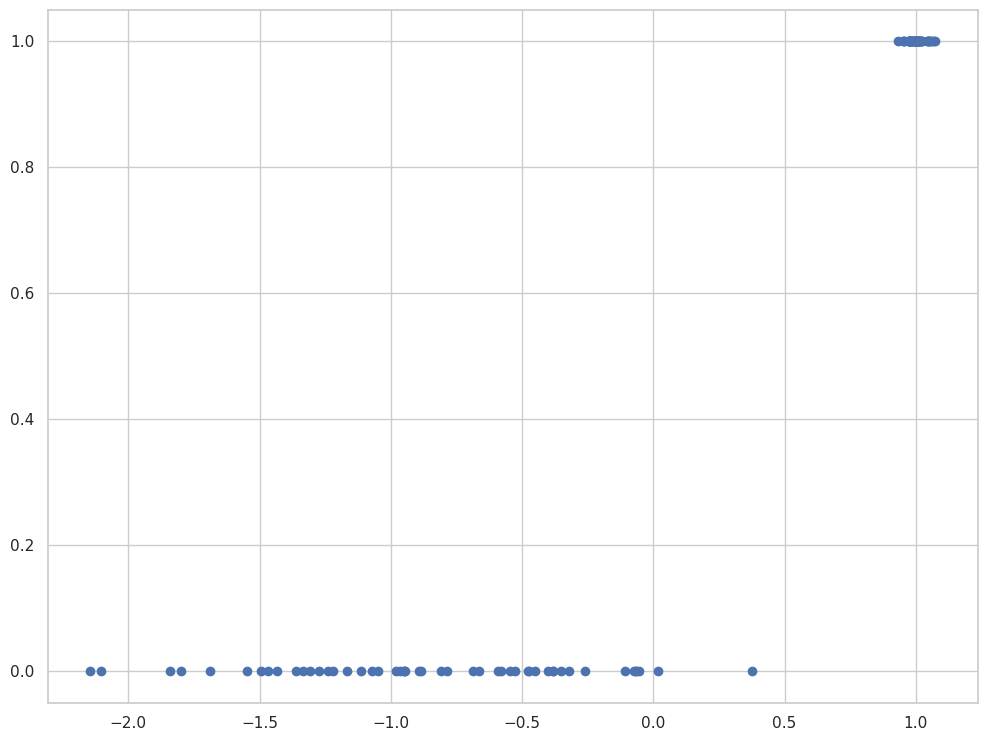

In [37]:
plt.scatter(X, y);

In [38]:
custom_log_reg = CustomLogisticRegression()
custom_log_reg.fit(X, y)
y_pred = custom_log_reg.predict(X)

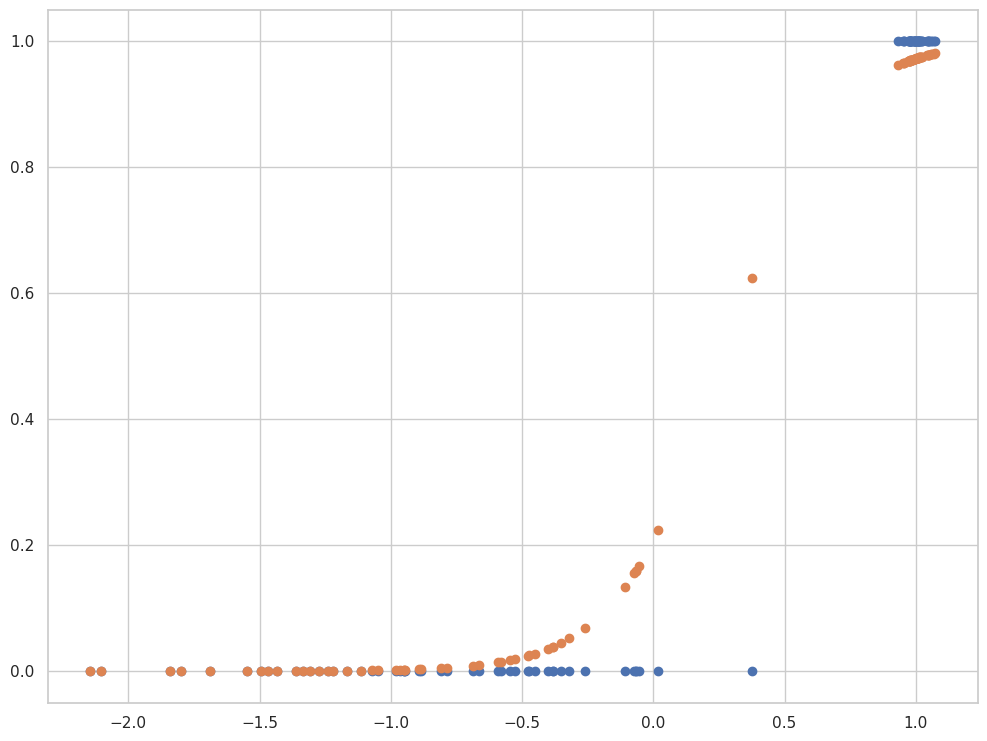

In [39]:
plt.scatter(X, y)
plt.scatter(X, y_pred);

Проверьте качество работы модели при помощи известных вам метрик бинарной классификации.

In [40]:
print(f'BCE = {round(bce(y, y_pred), 4)}',
      f'ROC AUC = {roc_auc_score(y, y_pred)}', sep='\n'
)

BCE = 232.0807
ROC AUC = 1.0


#### Задание 3.4. Применение логистической регрессии (5 баллов)

Мы будем использовать данные по свойствам покемонов (https://www.kaggle.com/abcsds/pokemon). В данном задании вам необходимо сначала сделать краткий EDA (Посмотреть на данные и их распределения, а также посмотреть, как различные признаки связаны между собой и с целевой переменной (`Legendary`)).

In [41]:
pokemon = pd.read_csv("../data_folder/raw_data/Pokemon.csv")
pokemon.head()

,#,Name,Type 1,Type 2,Total,HP,Attack,Defense,Sp. Atk,Sp. Def,Speed,Generation,Legendary
0,1,Bulbasaur,Grass,Poison,318,45,49,49,65,65,45,1,False
1,2,Ivysaur,Grass,Poison,405,60,62,63,80,80,60,1,False
2,3,Venusaur,Grass,Poison,525,80,82,83,100,100,80,1,False
3,3,VenusaurMega Venusaur,Grass,Poison,625,80,100,123,122,120,80,1,False
4,4,Charmander,Fire,NaN,309,39,52,43,60,50,65,1,False


Praise the Omnissiah! Welcome to the Sanctum of Exploratory Data Analysis.

Number of Observations (Rows): 800
Number of Parameters (Columns): 13

Data Types of Each Column:
#            int64
Name         object
Type 1       category
Type 2       category
Total        int64
HP           int64
Attack       int64
Defense      int64
Sp. Atk      int64
Sp. Def      int64
Speed        int64
Generation   category
Legendary    category

Numerical features: #, Total, HP, Attack, Defense, Sp. Atk, Sp. Def, Speed
String features: Name
Categorical features: Type 1, Type 2, Generation, Legendary

Counts and Frequencies for Categorical Features:
          count  Frequency
Type 1                    
Bug          69    0.08625
Dark         31    0.03875
Dragon       32    0.04000
Electric     44    0.05500
Fairy        17    0.02125
Fighting     27    0.03375
Fire         52    0.06500
Flying        4    0.00500
Ghost        32    0.04000
Grass        70    0.08750
Ground       32    0.04000
Ice    

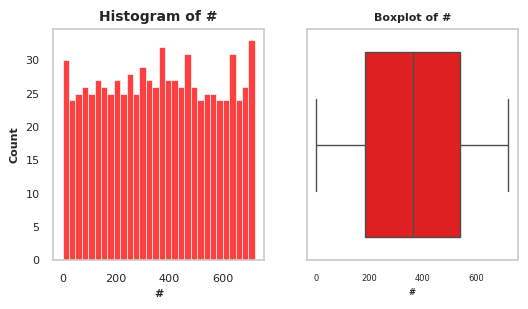

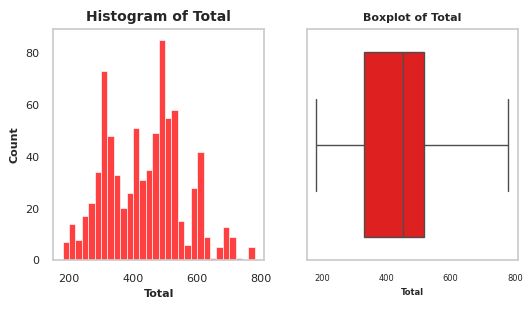

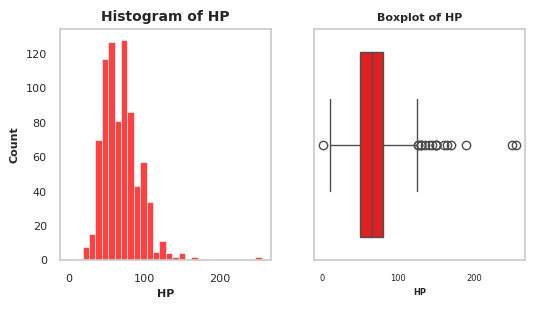

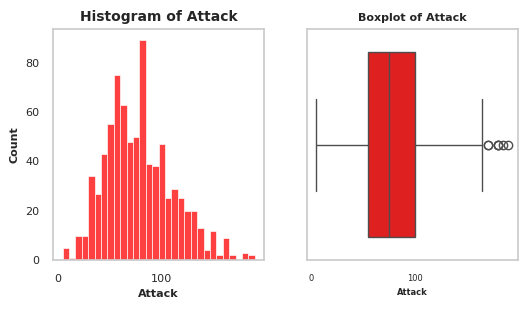

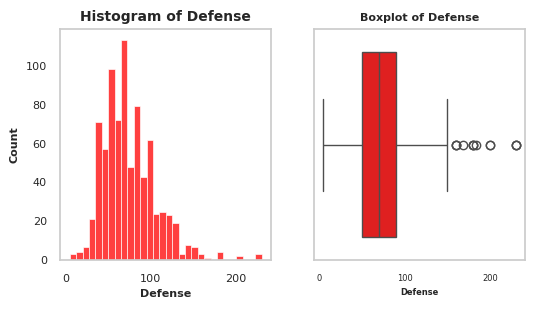

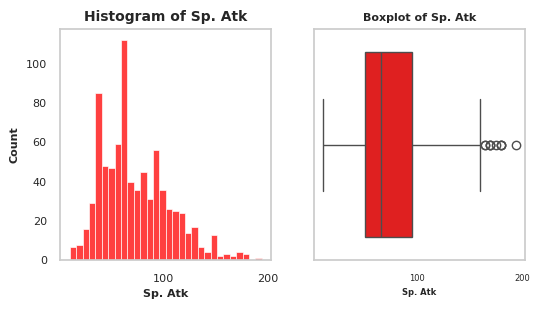

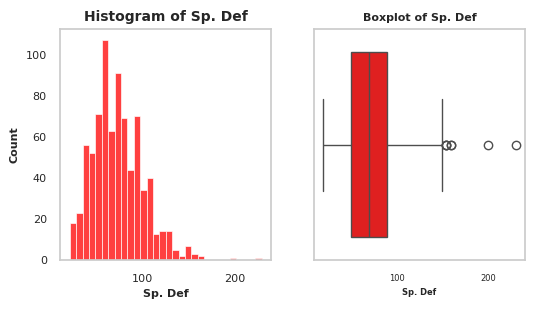

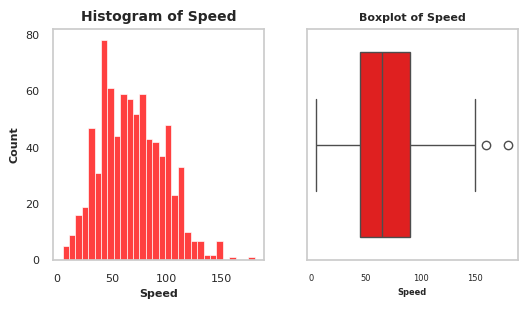


Correlation Heatmap:


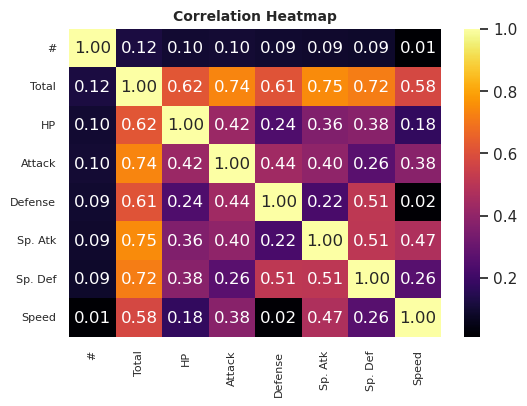


Outliers for Numerical Features:
#: 0
Total: 0
HP: 19
Attack: 7
Defense: 13
Sp. Atk: 10
Sp. Def: 7
Speed: 2

Missing Values:
Total Missing Values: 386
Rows with Missing Values: 386
Columns with Missing Values: Type 2

Missing Values Proportion:


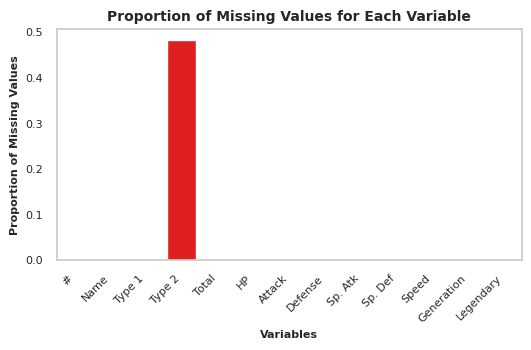


Duplicate Rows:
Number of Duplicate Rows: 0

May the data guide you, and the Omnissiah bless your analysis.


In [42]:
run_eda(pokemon, category_values=20)

* #: ID for each pokemon
* Name: Name of each pokemon
* Type 1: Each pokemon has a type, this determines weakness/resistance to attacks
* Type 2: Some pokemon are dual type and have 2
* Total: sum of all stats that come after this, a general guide to how strong a pokemon is
* HP: hit points, or health, defines how much damage a pokemon can withstand before fainting
* Attack: the base modifier for normal attacks (eg. Scratch, Punch)
* Defense: the base damage resistance against normal attacks
* SP Atk: special attack, the base modifier for special attacks (e.g. fire blast, bubble beam)
* SP Def: the base damage resistance against special attacks
* Speed: determines which pokemon attacks first each round

Итак, у нас есть датасет с 8 числовыми характеристиками (по факту с 7, потому что ID не то чтобы числовая фича, мы ее уберем), имя покемона, которое тоже вряд ли поможет нам с предсказанием, 4 категориальных переменных, включая наш таргет. В таргете, кстати, больше 90% False - перекос в данных. Тип 1 и тип 2 имеют много градаций, плюс у типа 2 много пропущенных значений (почти половина), поэтому очень хочется просто ввести параметр наличия/отсутствия второго типа. Значимых корреляций нет, выбросы есть, но их немного. Стандартизацию проводить будем.

Мы будем предсказывать является ли покемон легендарным или нет. Замените логическое значение колонки на числовое (перекодировав на 0 и 1). Также подумайте, как в этом случае лучше закодировать категориальные признаки (может быть, лучше их просто выбросить?).

In [43]:
pokemon[['Legendary']] = pokemon[['Legendary']].astype(int)
pokemon['Two types'] = pokemon['Type 2'].notna().astype(int)

In [44]:
cat_cols = ['Two types', 'Generation']
num_cols = ['Total', 'HP', 'Attack', 'Defense', 'Sp. Atk', 'Sp. Def', 'Speed']
all_features = cat_cols + num_cols

target = pokemon['Legendary'].values

X = pokemon[all_features]
y = target

Разделите ваши данные на тестовую и тренировочную выборку.

In [45]:
X_train, X_test, y_train, y_test = train_test_split(X,
                                                    y,
                                                    test_size=0.25,
                                                    random_state=SEED)

Обучите модель `LogisticRegression` из `sklearn`.

In [46]:
preprocessor = ColumnTransformer(transformers=[
    ("scaler", StandardScaler(), num_cols),
    ("ohe", OneHotEncoder(drop="first"), cat_cols)
])
preprocessor

ColumnTransformer(transformers=[('scaler', StandardScaler(),
                                 ['Total', 'HP', 'Attack', 'Defense', 'Sp. Atk',
                                  'Sp. Def', 'Speed']),
                                ('ohe', OneHotEncoder(drop='first'),
                                 ['Two types', 'Generation'])])

In [47]:
logreg_pipeline = Pipeline(steps=[
    ("preprocessor", preprocessor),
    ("logreg", LogisticRegression())
])
logreg_pipeline

Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('scaler', StandardScaler(),
                                                  ['Total', 'HP', 'Attack',
                                                   'Defense', 'Sp. Atk',
                                                   'Sp. Def', 'Speed']),
                                                 ('ohe',
                                                  OneHotEncoder(drop='first'),
                                                  ['Two types',
                                                   'Generation'])])),
                ('logreg', LogisticRegression())])

In [48]:
logreg_pipeline.fit(X_train, y_train)
y_predicted = logreg_pipeline.predict(X_test)  # предсказываем лейбл
y_predicted_proba = logreg_pipeline.predict_proba(X_test)  #предсказываем вероятности принадлежности к 0 и принадлежности к 1

Выведите метрики вашего классификатора:

1. Нарисуйте [confusion matrix](https://scikit-learn.org/stable/modules/generated/sklearn.metrics.plot_confusion_matrix.html).

2. Изобразите ROC кривую и посчитайте площадь под ней.

3. Скажите, какие признаки оказались наиболее важны для модели.

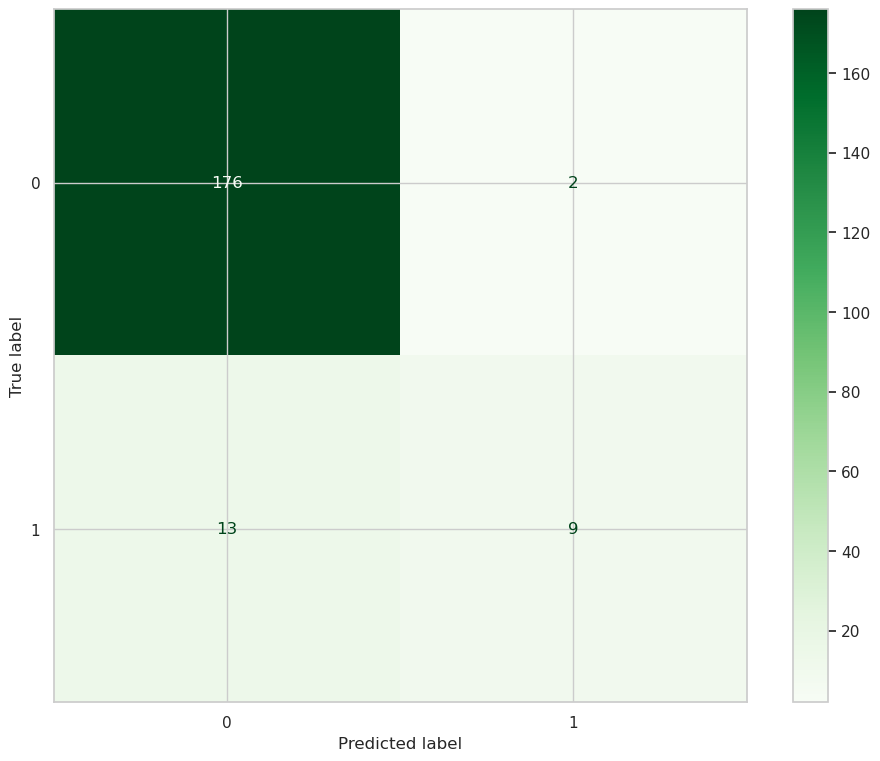

In [49]:
cm = confusion_matrix(y_test, y_predicted)
ConfusionMatrixDisplay(confusion_matrix=cm).plot(cmap='Greens')

In [50]:
print(f'precision_score = {round(precision_score(y_test, y_predicted), 2)}',
      f'recall = {round(recall_score(y_test, y_predicted), 2)}',
      f'f_1 = {round(f1_score(y_test, y_predicted), 2)}',
      f'accuracy = {round(accuracy_score(y_test, y_predicted), 2)}', sep='\n'
     )

precision_score = 0.82
recall = 0.41
f_1 = 0.55
accuracy = 0.93


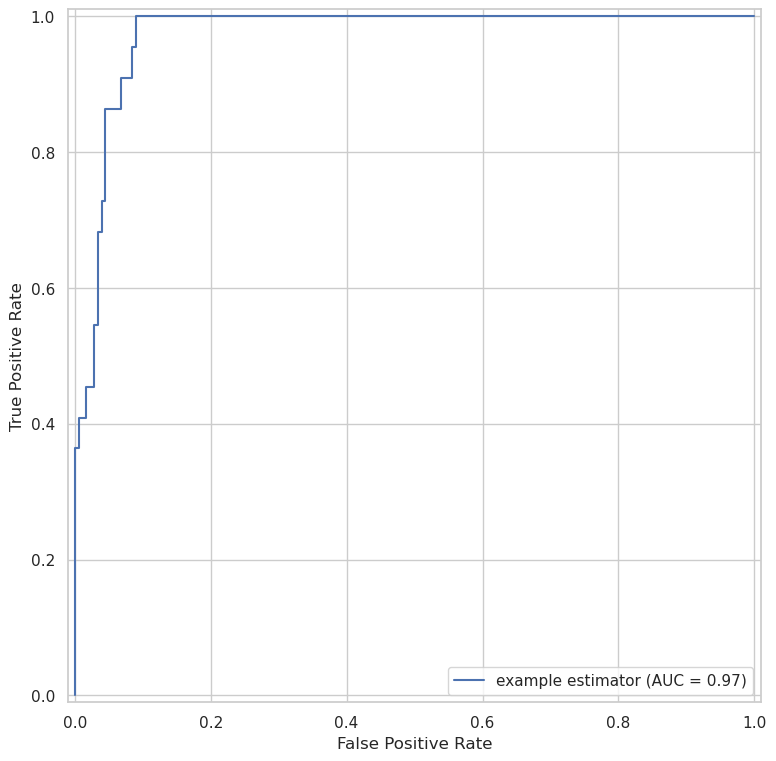

In [51]:
fpr, tpr, thresholds = roc_curve(y_test, y_predicted_proba[:, 1])
roc_auc = auc(fpr, tpr)
RocCurveDisplay(fpr=fpr, tpr=tpr, roc_auc=roc_auc, estimator_name='example estimator').plot()

Если ориентироваться на accuracy и AUC, то можно сказать, что вышла хорошая модель, но наши данные несбалансированы, и модель чаще предскаживает "не легендарность". Если посмотреть на recall, то можно увидеть, что принадлежность к классу "легендарный" модель предсказывает плохо (recall = 0.41)

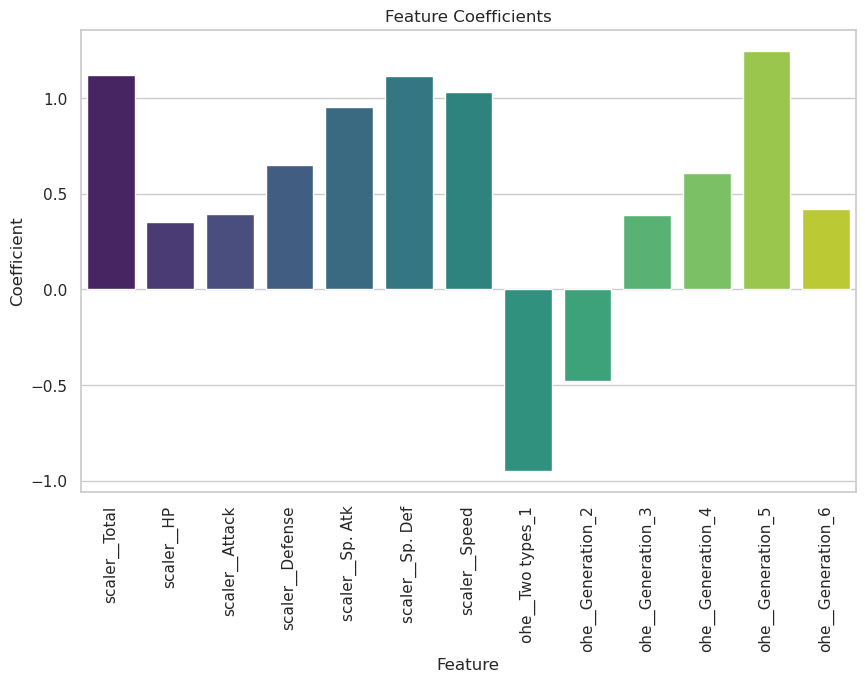

In [52]:
final_model = logreg_pipeline.named_steps['logreg']
coefficients = final_model.coef_.flatten()
feature_names = preprocessor.get_feature_names_out()
coef_df = pd.DataFrame({'Feature': feature_names, 'Coefficient': coefficients})

plt.figure(figsize=(10, 6))
sns.barplot(x='Feature', y='Coefficient', data=coef_df, hue='Feature', palette='viridis', legend=False)
plt.title('Feature Coefficients')
plt.xticks(rotation=90)
plt.show()

In [53]:
coef_df

,Feature,Coefficient
0,scaler__Total,1.121990
1,scaler__HP,0.350891
2,scaler__Attack,0.394358
3,scaler__Defense,0.650409
4,scaler__Sp. Atk,0.952861
5,scaler__Sp. Def,1.117264
6,scaler__Speed,1.033182
7,ohe__Two types_1,-0.947070
8,ohe__Generation_2,-0.480920
9,ohe__Generation_3,0.386047


Наиболее значимые фичи - Generation_5, Total, Sp. Def и Speed

### Задание 4. Расскажите о вашей любимой музыкальной группе (исполнителе) (0.5 балла)

Расскажите, как вы познакомились с этой группой и скиньте несколько наиболее любимых треков)

О, это самый сложный вопрос!! У меня много любимых песен, я не могу выбрать какая же группа моя любимая) У меня много всего под настроение)
Ну, пусть будет Oomph!
Нашла их клипы на странице ВК у своей подруги, послушала и мне понравилось!) С их песнями связано очень много воспоминаний, и счастливых, и не совсем, но я их все равно люблю. Балы на 5 концертах, и даже взяла умудрилась взять автограф у вокалиста. Один из концертов особенно запомнился - они выступали с симфоническим оркестром, должна была потом выйти запись этого концерта, но что-то пошло не так, и запись так и не вышла. А пару лет назад у них поменялся вокалист, новые альбомы я не слушала, не знаю - может послушаю и мне понравится, но пока не хочу.

Еще из интересных фактов - под песню Gott ist ein Popstar состоялся мой первый запуск секвенатора, еще 454(Roche). Коллега предложил прочитать молитву "Отче наш", и желательно на немецком, и надо было видеть его лицо, когда я сказала "Да не вопрос! Vater unser im Himmel geheiligt werde dein Name..."

In [54]:
display(Audio('../data_folder/raw_data/Gott_ist_ein_Popstar.mp3'))
display(Audio('../data_folder/raw_data/Zwei_Schritte_vor.mp3'))
display(Audio('../data_folder/raw_data/geborn_zu_sterben.mp3'))

## Therapy time

Напишите здесь ваши впечатления о задании: было ли интересно, было ли слишком легко или наоборот сложно и тд. Также сюда можно написать свои идеи по улучшению заданий, а также предложить данные, на основе которых вы бы хотели построить следующие дз. 

**Ваши мысли:**

Это правда было не так больно, как в первый раз... но я все равно периодически думала, какая дорога привела меня в ИБ, и вообще вспоминала всю свою биографию. Стоило ли мне поступать в медицинский? почему я не стала патологоанатомом? зачем я пошла в генетику? сдался мне этот NGS, могла бы спокойно капать ПЦРы... ну и вот это все)))

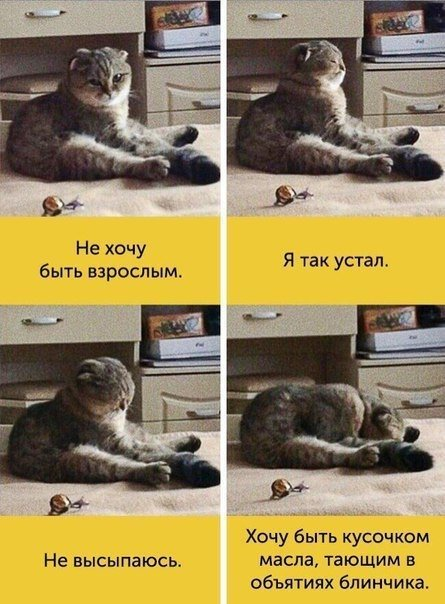

In [55]:
Image('../data_folder/raw_data/cat.jpg')